<a href="https://colab.research.google.com/github/yongj01/AHI-Final-Project/blob/main/Diabetes_Final_Project_(UPDATED).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib as plt
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction 

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
                            precision_score, recall_score, roc_auc_score,\
                            plot_confusion_matrix, classification_report, plot_roc_curve, f1_score

import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates
import warnings
from google.colab import files
import io

!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearn
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
from catboost import CatBoostClassifier
warnings.filterwarnings("ignore")
print('complete')

     |████████████████████████████████| 76.6 MB 59 kB/s 
complete


# Loading original dataset

In [ ]:
uploaded = files.upload()

In [ ]:
data = pd.read_csv("diabetic_data(1).csv")

In [ ]:
data.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [ ]:
data.duplicated().sum()

0

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101766 non-null  int64 
 1   patient_nbr               101766 non-null  int64 
 2   race                      101766 non-null  object
 3   gender                    101766 non-null  object
 4   age                       101766 non-null  object
 5   weight                    101766 non-null  object
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  payer_code                101766 non-null  object
 11  medical_specialty         101766 non-null  object
 12  num_lab_procedures        101766 non-null  int64 
 13  num_procedures            101766 non-null  int64 
 14  num_

# DATA CLEANING AND NORMALIZATION

### Dropping columns that are irrelevant or have too many missing values

In [ ]:
data.drop(['encounter_id'], axis = 1, inplace = True)
data.drop(['patient_nbr'], axis = 1, inplace = True)
data.drop(['diag_1'], axis = 1, inplace = True)
data.drop(['diag_2'], axis = 1, inplace = True)
data.drop(['diag_3'], axis = 1, inplace = True)
data.drop(['payer_code'], axis = 1, inplace = True)
data.drop(['medical_specialty'], axis = 1, inplace = True)
data.drop(['weight'], axis = 1, inplace = True)

### Data normalization

In [ ]:
data['max_glu_serum'].replace({'None':0, 'Norm':1, '>200':2, '>300':3}, inplace=True)
data['A1Cresult'].replace({'None':0, 'Norm':1, '>7':7, '>8':8}, inplace=True)

In [ ]:
data['metformin'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['repaglinide'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['nateglinide'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['chlorpropamide'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['glimepiride'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['acetohexamide'].replace({'No':0, 'Steady':2}, inplace=True)
data['miglitol'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['glipizide'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['acarbose'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['glyburide'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['pioglitazone'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['rosiglitazone'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['tolbutamide'].replace({'No':0, 'Steady':2}, inplace=True)
data['troglitazone'].replace({'No':0, 'Steady':2}, inplace=True)
data['tolazamide'].replace({'No':0, 'Steady':2, 'Up':3}, inplace=True)
data['examide'].replace({'No':0}, inplace=True)
data['citoglipton'].replace({'No':0}, inplace=True)
data['insulin'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['glyburide-metformin'].replace({'No':0, 'Down':1, 'Steady':2, 'Up':3}, inplace=True)
data['glipizide-metformin'].replace({'No':0, 'Steady':2}, inplace=True)
data['glimepiride-pioglitazone'].replace({'No':0, 'Steady':2}, inplace=True)
data['metformin-rosiglitazone'].replace({'No':0, 'Steady':2}, inplace=True)
data['metformin-pioglitazone'].replace({'No':0, 'Steady':2}, inplace=True)

In [ ]:
data['diabetesMed'].replace({'No':0, 'Yes':1}, inplace=True)

In [ ]:
data['readmitted'].replace({'NO':0, '<30':1, '>30':2}, inplace=True)

In [ ]:
data['change'].replace({'No':0, 'Ch':1}, inplace=True)

In [ ]:
data['age'].replace({'[0-10)':5, '[10-20)':15, '[20-30)':25, '[30-40)':35, '[40-50)':45, '[50-60)':55, '[60-70)':65, '[70-80)':75, '[80-90)':85, '[90-100)':95}, inplace=True)

In [ ]:
data.drop(data[data['gender'] >= 'Unknown/Invalid'].index, inplace = True)

In [ ]:
data['gender'].replace({'Male':1, 'Female':0}, inplace=True)

In [ ]:
data['race'].replace({'?':'Unknown'}, inplace=True)

## Transforming cleaned dataset into a csv file

In [ ]:
data.to_csv('cleandatadiabetes.csv', index=False)
data.to_csv('C:/Users/natha/Downloads/cleandatadiabetes.csv')

FileNotFoundError: ignored

# Graphing imbalanced data (Not really relevant to project)

In [ ]:
fig = px.histogram(data, x="admission_type_id", title='Admission type ID and Readmission', color='readmitted', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x="number_diagnoses", title="Number Diagnoses", color='readmitted', width=500, height=500)
fig.show()

In [ ]:
fig = px.histogram(data, x="num_procedures", title='Type ID', color='readmitted', width=500, height=500)
fig.show()

In [ ]:
fig = px.histogram(data, x="readmitted", title='readmitted', color='readmitted', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

In [ ]:
data['readmitted'].replace({0:"No Readmission", 1:"Readmitted within 30 Day", 2:"Readmitted after 30 Days"}, inplace=True)

In [ ]:
data['gender'].replace({1:"Male", 0:"Female"}, inplace=True)

In [ ]:
fig = px.histogram(data, x='gender' , color='readmitted',
                   title='Gender and Readmission Status',
                   width=600, height=400,
                   labels={
                       "gender": "Gender", "readmitted": "Readmission Status"},
                   category_orders={
                       "gender": ["0", "1"], "readmitted": ["No Readmission", "Readmitted after 30 days", "Readmitted within 30 days"]
                   },
                   hover_data = data[['gender']])

In [ ]:
fig.update_xaxes(type='category')
fig.show()

In [ ]:
data['gender'].replace({'Male':1, 'Female':0}, inplace=True)

In [ ]:
fig = px.histogram(data, x="age", title='age', color='age', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x='age', title='Age on Readmission Status', color='readmitted', hover_data = data[['readmitted']])
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x="race", title='race', color='race', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x='race', title='Race on Readmission Status', color='readmitted', hover_data = data[['readmitted']])

In [ ]:
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x='time_in_hospital', color='readmitted')
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.scatter(data, x="time_in_hospital", y='age', title='Time in Hospital and Age', color='readmitted', width=500, height=500)
fig.show()

In [ ]:
fig = px.histogram(data, x='discharge_disposition_id', color='readmitted')
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x='admission_source_id', color='readmitted')
fig.update_xaxes(type='category')
fig.show()

In [ ]:
fig = px.histogram(data, x='num_procedures', color='readmitted')
fig.update_xaxes(type='category')
fig.show()

#### Made seperate dataframe only including data from readmitted within 30 days

In [ ]:
df2 = data.copy()

In [ ]:
df2['readmitted'].replace({"No Readmission":0, "Readmitted within 30 Day":1, "Readmitted after 30 Days":2}, inplace=True)

In [ ]:
df2.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,0,5,6,25,1,1,41,0,1,...,0,0,0,0,0,0,0,0,0,0
1,Caucasian,0,15,1,1,7,3,59,0,18,...,0,3,0,0,0,0,0,1,1,2
2,AfricanAmerican,0,25,1,1,7,2,11,5,13,...,0,0,0,0,0,0,0,0,1,0
3,Caucasian,1,35,1,1,7,2,44,1,16,...,0,3,0,0,0,0,0,1,1,0
4,Caucasian,1,45,1,1,7,1,51,0,8,...,0,2,0,0,0,0,0,1,1,0


In [ ]:
df3 = df2.loc[df2['readmitted'] == 1 ]

In [ ]:
df3.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
11,AfricanAmerican,1,65,2,1,4,7,62,0,11,...,0,2,0,0,0,0,0,1,1,1
12,Caucasian,0,45,1,3,7,7,60,0,15,...,0,1,0,0,0,0,0,1,1,1
16,AfricanAmerican,1,55,1,1,7,4,45,4,17,...,0,2,0,0,0,0,0,1,1,1
46,Caucasian,0,75,3,5,4,9,25,3,16,...,0,1,0,0,0,0,0,1,1,1
50,AfricanAmerican,1,55,2,1,2,4,40,1,14,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
fig = px.histogram(df3, x="time_in_hospital")
fig.show()

In [ ]:
fig = px.histogram(df3, x="age")
fig.show()

In [ ]:
fig = px.histogram(df3, x="diabetesMed", color="diabetesMed")
fig.update_xaxes(type='category')
fig.show()

# Insights into the target variable

In [ ]:
data['readmitted'].replace({"No Readmission":0, "Readmitted within 30 Day":1, "Readmitted after 30 Days":2}, inplace=True)

In [ ]:
data['race'].replace({"Caucasian":0, "AfricanAmerican":1, "Hispanic":2, "Asian":3, "Other":4, "Unknown":5}, inplace=True)

In [ ]:
data.head()

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,0,0,5,6,25,1,1,41,0,1,...,0,0,0,0,0,0,0,0,0,0
1,0,0,15,1,1,7,3,59,0,18,...,0,3,0,0,0,0,0,1,1,2
2,1,0,25,1,1,7,2,11,5,13,...,0,0,0,0,0,0,0,0,1,0
3,0,1,35,1,1,7,2,44,1,16,...,0,3,0,0,0,0,0,1,1,0
4,0,1,45,1,1,7,1,51,0,8,...,0,2,0,0,0,0,0,1,1,0


In [ ]:
datat = data.copy()

In [ ]:
datat['readmitted'].replace({2:1}, inplace=True)

Made copy of data set, new dataframe (datat) will combine data for readmission within 30 days and readmission after 30 days

In [ ]:
y = datat['readmitted']
print(f'Percentage of patients readmitted : % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patients)\nPercentage of patients not readmitted: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} patients)')

Percentage of patients readmitted : % 46.09 --> (46902 patients)
Percentage of patients not readmitted: % 53.91 --> (54861 patients)


In [ ]:
datat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101763 entries, 0 to 101765
Data columns (total 42 columns):
 #   Column                    Non-Null Count   Dtype
---  ------                    --------------   -----
 0   race                      101763 non-null  int64
 1   gender                    101763 non-null  int64
 2   age                       101763 non-null  int64
 3   admission_type_id         101763 non-null  int64
 4   discharge_disposition_id  101763 non-null  int64
 5   admission_source_id       101763 non-null  int64
 6   time_in_hospital          101763 non-null  int64
 7   num_lab_procedures        101763 non-null  int64
 8   num_procedures            101763 non-null  int64
 9   num_medications           101763 non-null  int64
 10  number_outpatient         101763 non-null  int64
 11  number_emergency          101763 non-null  int64
 12  number_inpatient          101763 non-null  int64
 13  number_diagnoses          101763 non-null  int64
 14  max_glu_serum       

# Metrics of importance

In [ ]:
numerical = ['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']

categorical = ['race', 'gender', 'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'max_glu_serum', 'A1Cresult', 'change', 'diabetesMed']

medications = ['metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone', 'metformin-pioglitazone']

## 1. Numerical variables

In [ ]:
datat[numerical].describe()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000
mean,65.966854,4.396018,43.095909,1.339691,16.021835,0.369368,0.197842,0.635585,7.422649
std,15.941022,2.985092,19.674220,1.705792,8.127589,1.267282,0.930485,1.262877,1.933578
min,5.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,55.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,65.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,0.000000,8.000000
75%,75.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,95.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


In [ ]:
datat[numerical].skew()

age                   -0.630507
time_in_hospital       1.134030
num_lab_procedures    -0.236531
num_procedures         1.316460
num_medications        1.326716
number_outpatient      8.832837
number_emergency      22.855272
number_inpatient       3.614085
number_diagnoses      -0.876799
dtype: float64

### Univariate analysis

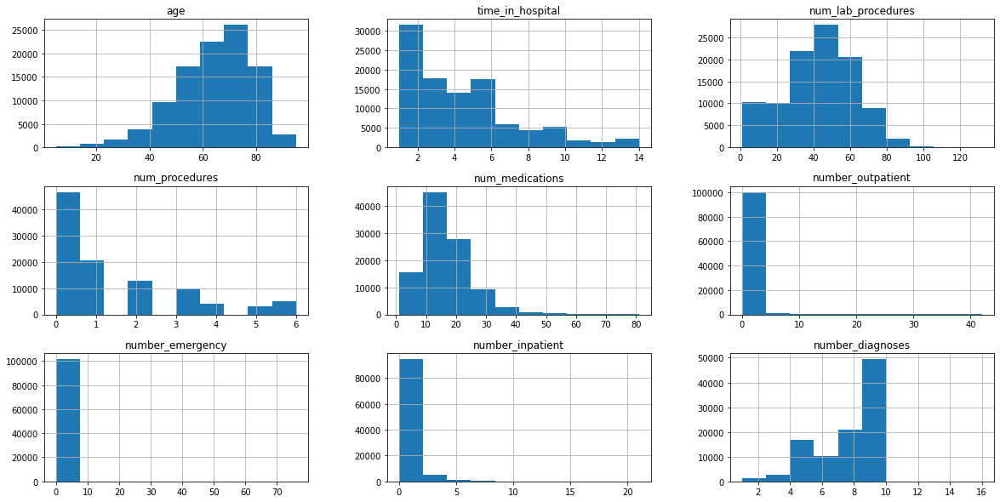

In [ ]:
datat[numerical].hist(figsize=(20,10));

### Correlation matrix

In [ ]:
datat[['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'readmitted']
].corr()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,readmitted
age,1.000000,0.107516,0.020777,-0.030119,0.041839,0.023727,-0.087289,-0.042856,0.242609,0.030413
time_in_hospital,0.107516,1.000000,0.318429,0.191497,0.466137,-0.008919,-0.009683,0.073619,0.220153,0.051281
num_lab_procedures,0.020777,0.318429,1.000000,0.058105,0.268176,-0.007606,-0.002282,0.039225,0.152737,0.039242
num_procedures,-0.030119,0.191497,0.058105,1.000000,0.385761,-0.024813,-0.038175,-0.066226,0.073769,-0.044728
num_medications,0.041839,0.466137,0.268176,0.385761,1.000000,0.045198,0.013180,0.064196,0.261529,0.046774
number_outpatient,0.023727,-0.008919,-0.007606,-0.024813,0.045198,1.000000,0.091457,0.107334,0.094148,0.082135
number_emergency,-0.087289,-0.009683,-0.002282,-0.038175,0.013180,0.091457,1.000000,0.266557,0.055536,0.103006
number_inpatient,-0.042856,0.073619,0.039225,-0.066226,0.064196,0.107334,0.266557,1.000000,0.104703,0.217184
number_diagnoses,0.242609,0.220153,0.152737,0.073769,0.261529,0.094148,0.055536,0.104703,1.000000,0.112549
readmitted,0.030413,0.051281,0.039242,-0.044728,0.046774,0.082135,0.103006,0.217184,0.112549,1.000000


## 2. Categorical variables

In [ ]:
categorical = ['race', 'gender', 'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'max_glu_serum', 'A1Cresult', 'change', 'diabetesMed']
medications = ['metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone', 'metformin-pioglitazone']

### Mutual info score

In [ ]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, datat['readmitted']) 

datat_cat = datat[categorical].apply(cat_mut_inf) 
datat_cat = datat_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
datat_cat

,mutual_info_score
discharge_disposition_id,0.015195
admission_source_id,0.005478
admission_type_id,0.001937
diabetesMed,0.001902
race,0.001395
change,0.001059
A1Cresult,0.000264
max_glu_serum,0.000241
gender,0.000162


In [ ]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, datat['readmitted']) 

datat_cat = datat[medications].apply(cat_mut_inf) 
datat_cat = datat_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
datat_cat

,mutual_info_score
insulin,0.002338
metformin,0.000414
repaglinide,0.000254
glipizide,0.000223
rosiglitazone,0.000146
acarbose,0.000109
pioglitazone,0.000081
miglitol,0.000047
glyburide-metformin,0.000038
chlorpropamide,0.000025


### Histograms

In [ ]:
print (f'{round(datat["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="gender", title='Gender', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    53.76
1    46.24
Name: gender, dtype: float64


In [ ]:
print (f'{round(datat["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="race", title='Race', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    74.78
1    18.88
5     2.23
2     2.00
4     1.48
3     0.63
Name: race, dtype: float64


In [ ]:
print (f'{round(datat["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="admission_type_id", title='admission_type_id', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

1    53.05
3    18.54
2    18.16
6     5.20
5     4.70
8     0.31
7     0.02
4     0.01
Name: admission_type_id, dtype: float64


In [ ]:
print (f'{round(datat["discharge_disposition_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="discharge_disposition_id", title='discharge_disposition_id', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

1     59.19
3     13.71
6     12.68
18     3.63
2      2.09
22     1.96
11     1.61
5      1.16
25     0.97
4      0.80
7      0.61
23     0.40
13     0.39
14     0.37
28     0.14
8      0.11
15     0.06
24     0.05
9      0.02
17     0.01
16     0.01
19     0.01
10     0.01
27     0.00
12     0.00
20     0.00
Name: discharge_disposition_id, dtype: float64


In [ ]:
print (f'{round(datat["admission_source_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="admission_source_id", title='admission_source_id', width=500, height=500)
fig.show()

7     56.50
1     29.05
17     6.66
4      3.13
6      2.22
2      1.08
5      0.84
3      0.18
20     0.16
9      0.12
8      0.02
22     0.01
10     0.01
14     0.00
11     0.00
25     0.00
13     0.00
Name: admission_source_id, dtype: float64


In [ ]:
print (f'{round(datat["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="max_glu_serum", title='max_glu_serum', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    94.75
1     2.55
2     1.46
3     1.24
Name: max_glu_serum, dtype: float64


In [ ]:
print (f'{round(datat["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="A1Cresult", title='A1Cresult', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    83.28
8     8.07
1     4.90
7     3.75
Name: A1Cresult, dtype: float64


In [ ]:
print (f'{round(datat["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="change", title='change', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    53.81
1    46.19
Name: change, dtype: float64


In [ ]:
print (f'{round(datat["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="diabetesMed", title='diabetesMed', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

1    77.0
0    23.0
Name: diabetesMed, dtype: float64


In [ ]:
print (f'{round(datat["insulin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="insulin", title='insulin', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    46.56
2    30.31
1    12.01
3    11.12
Name: insulin, dtype: float64


In [ ]:
print (f'{round(datat["metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(datat, x="metformin", title='metformin', width=500, height=500)
fig.update_xaxes(type='category')
fig.show()

0    80.36
2    18.03
3     1.05
1     0.57
Name: metformin, dtype: float64


### Bivariate analysis

In [ ]:
print (f'A "female" has a probability of {round(datat[datat["gender"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'A "Male" has a probability of {round(datat[datat["gender"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


A "female" has a probability of 46.92 % to be readmitted within 30 days

A "Male" has a probability of 45.12 % to be readmitted within 30 days


In [ ]:
print (f'Caucasian race group probability: {round(datat[datat["race"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'African American race group probability: {round(datat[datat["race"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Hispanic race group probability: {round(datat[datat["race"]==2]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Asian race group probability: {round(datat[datat["race"]==3]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Other race group probability: {round(datat[datat["race"]==4]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Unknown race group probability: {round(datat[datat["race"]==5]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')



Caucasian race group probability: 46.93 % to be readmitted within 30 days

African American race group probability: 45.75 % to be readmitted within 30 days

Hispanic race group probability: 41.92 % to be readmitted within 30 days

Asian race group probability: 35.26 % to be readmitted within 30 days

Other race group probability: 39.27 % to be readmitted within 30 days

Unknown race group probability: 31.97 % to be readmitted within 30 days


In [ ]:
print (f'Admission type 1: {round(datat[datat["admission_type_id"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 2: {round(datat[datat["admission_type_id"]==2]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 3: {round(datat[datat["admission_type_id"]==3]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 4: {round(datat[datat["admission_type_id"]==4]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 5: {round(datat[datat["admission_type_id"]==5]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 6: {round(datat[datat["admission_type_id"]==6]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 7: {round(datat[datat["admission_type_id"]==7]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Admission type 8: {round(datat[datat["admission_type_id"]==8]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


Admission type 1: 47.29 % to be readmitted within 30 days

Admission type 2: 46.09 % to be readmitted within 30 days

Admission type 3: 40.85 % to be readmitted within 30 days

Admission type 4: 30.0 % to be readmitted within 30 days

Admission type 5: 46.31 % to be readmitted within 30 days

Admission type 6: 53.24 % to be readmitted within 30 days

Admission type 7: 0.0 % to be readmitted within 30 days

Admission type 8: 34.69 % to be readmitted within 30 days


In [ ]:
print (f'None: {round(datat[datat["max_glu_serum"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Norm: {round(datat[datat["max_glu_serum"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'>200: {round(datat[datat["max_glu_serum"]==2]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'>300: {round(datat[datat["max_glu_serum"]==3]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


None: 45.95 % to be readmitted within 30 days

Norm: 45.44 % to be readmitted within 30 days

>200: 48.15 % to be readmitted within 30 days

>300: 55.54 % to be readmitted within 30 days


In [ ]:
print (f'None: {round(datat[datat["A1Cresult"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Norm: {round(datat[datat["A1Cresult"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'>7: {round(datat[datat["A1Cresult"]==7]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'>8: {round(datat[datat["A1Cresult"]==8]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


None: 46.52 % to be readmitted within 30 days

Norm: 41.7 % to be readmitted within 30 days

>7: 44.15 % to be readmitted within 30 days

>8: 45.18 % to be readmitted within 30 days


In [ ]:
print (f'No change: {round(datat[datat["change"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Change: {round(datat[datat["change"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


No change: 43.96 % to be readmitted within 30 days

Change: 48.57 % to be readmitted within 30 days


In [ ]:
print (f'No: {round(datat[datat["diabetesMed"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Yes: {round(datat[datat["diabetesMed"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


No: 40.48 % to be readmitted within 30 days

Yes: 47.76 % to be readmitted within 30 days


In [ ]:
print (f'No: {round(datat[datat["metformin"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Down: {round(datat[datat["metformin"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Steady: {round(datat[datat["metformin"]==2]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Up: {round(datat[datat["metformin"]==3]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


No: 46.78 % to be readmitted within 30 days

Down: 45.04 % to be readmitted within 30 days

Steady: 43.34 % to be readmitted within 30 days

Up: 40.77 % to be readmitted within 30 days


In [ ]:
print (f'No: {round(datat[datat["insulin"]==0]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Down: {round(datat[datat["insulin"]==1]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Steady: {round(datat[datat["insulin"]==2]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')

print()

print (f'Up: {round(datat[datat["insulin"]==3]["readmitted"].mean()*100,2)} % to be readmitted within 30 days')


No: 43.7 % to be readmitted within 30 days

Down: 52.79 % to be readmitted within 30 days

Steady: 45.11 % to be readmitted within 30 days

Up: 51.54 % to be readmitted within 30 days


  # MODEL 1

# Linear and logistic regression

### No readmission = 0 , After 30 days = 0, Within 30 days = 1

In [ ]:
train_df, valid_df, test_df = np.split(datat.sample(frac=1, random_state=42),
                                      [int(.7*len(datat)), int(.85*len(datat))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

NameError: ignored

In [ ]:
datat.readmitted.value_counts()

In [ ]:
train_df.readmitted.value_counts()

In [ ]:
valid_df.readmitted.value_counts()

In [ ]:
test_df.readmitted.value_counts()

In [ ]:
def calc_prevalence(y_actual):
    return (sum(y_actual)/len(y_actual))

In [ ]:
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

In [ ]:
datat_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)], axis = 0)

In [ ]:
datat_df_balanced = datat_df_balanced.sample(n = len(datat_df_balanced), random_state = 42).reset_index(drop= True)

print('Train balanced prevalence(n = %d):%.3f'%(len(datat_df_balanced), \
                                               calc_prevalence(datat_df_balanced.readmitted.values)))

In [ ]:
datat_df_balanced.readmitted.value_counts()

In [ ]:
X_train = datat_df_balanced.drop('readmitted', axis=1)

y_train = datat_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted', axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted', axis=1)

y_test = test_df['readmitted']

In [ ]:
scaler = StandardScaler()
X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']] = pd.DataFrame(scaler.fit_transform(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']]),columns=['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum'])
X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']] = pd.DataFrame(scaler.transform(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']]),columns=['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum'])
X_test[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']] = pd.DataFrame(scaler.transform(X_test[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']]),columns=['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum'])
         

In [ ]:
def calc_specificity(y_actual, y_pred, thresh):
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)
def print_report(y_actual, y_pred, thresh = 0.5):
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

### Linear regression

In [ ]:
from sklearn.linear_model import LinearRegression
lnr = LinearRegression()
lnr.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

y_valid_preds = lnr.predict(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])

In [ ]:
y_valid_preds

In [ ]:
y_valid_preds.max()

In [ ]:
y_valid_preds.min()

### Logistic regression

In [ ]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

y_valid_preds = lr.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid, y_valid_preds, 0.5)

# KNN Model

In [ ]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

knn_preds = knn.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.575
accuracy:0.550
recall:0.587
precision:0.512
specificity:0.474
prevalence:0.463
 


The results of the KNN model show a lower recall value for the model containing the variables age, time_in_hospital, num_lab_procedures, and number_diagnosis, as opposed to the logistic regression results. The recall value of 0.597 indicated the percentage of such variables predicting our target variable, the liklihood of readmission within 30 days. It tells us how many out of the actual positives, are being predicted based on the variables used. Because AUC and accuracy are similar to the values given from the logistic regression, and the recall value is lower, for our project we would most likely not choose the KNN model for our final model.  

# Stochastic Gradient Descent Model

In [ ]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

sgd_preds = sgdc.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

Stochastic Gradient Descent
Validation:
AUC:0.566
accuracy:0.550
recall:0.662
precision:0.511
specificity:0.454
prevalence:0.463
 


# Decision Tree

In [ ]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:,1]
dc_preds = dc_clf.predict(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

AUC:0.574
accuracy:0.553
recall:0.658
precision:0.513
specificity:0.453
prevalence:0.463
 


# Random Forest

In [ ]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

rf_preds = rf_clf.predict(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])
rf_preds_proba = rf_clf.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

AUC:0.581
accuracy:0.551
recall:0.707
precision:0.510
specificity:0.417
prevalence:0.463
 


# Linear SVC

In [ ]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

AUC:0.566
accuracy:0.537
recall:0.000
precision:0.000
specificity:1.000
prevalence:0.463
 


# Gradient Boosting Model

In [ ]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)
gb_preds = gb_clf.predict(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])
gb_preds_proba = gb_clf.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

AUC:0.577
accuracy:0.551
recall:0.663
precision:0.511
specificity:0.455
prevalence:0.463
 


# XGB Model

In [ ]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)

xgb_preds = xgb_clf.predict(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])
xgb_preds_proba = xgb_clf.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

AUC:0.579
accuracy:0.554
recall:0.663
precision:0.513
specificity:0.459
prevalence:0.463
 


# Catboost Model

In [ ]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']], y_train)
catb_preds = catb.predict_proba(X_valid[['age', 'num_lab_procedures', 'number_diagnoses', 'max_glu_serum']])[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

0:	learn: 0.6855419	total: 58.3ms	remaining: 11.6s
1:	learn: 0.6838475	total: 67.8ms	remaining: 6.71s
2:	learn: 0.6834361	total: 80.2ms	remaining: 5.26s
3:	learn: 0.6828027	total: 90.5ms	remaining: 4.43s
4:	learn: 0.6826319	total: 99.1ms	remaining: 3.86s
5:	learn: 0.6823941	total: 108ms	remaining: 3.48s
6:	learn: 0.6823025	total: 116ms	remaining: 3.2s
7:	learn: 0.6822444	total: 131ms	remaining: 3.14s
8:	learn: 0.6819355	total: 142ms	remaining: 3.02s
9:	learn: 0.6818837	total: 156ms	remaining: 2.96s
10:	learn: 0.6816589	total: 166ms	remaining: 2.84s
11:	learn: 0.6814504	total: 175ms	remaining: 2.74s
12:	learn: 0.6812510	total: 183ms	remaining: 2.64s
13:	learn: 0.6811223	total: 194ms	remaining: 2.57s
14:	learn: 0.6810263	total: 204ms	remaining: 2.51s
15:	learn: 0.6809131	total: 213ms	remaining: 2.46s
16:	learn: 0.6808321	total: 222ms	remaining: 2.39s
17:	learn: 0.6806625	total: 232ms	remaining: 2.35s
18:	learn: 0.6805357	total: 241ms	remaining: 2.3s
19:	learn: 0.6804573	total: 257ms	rema

# Feature importance

In [ ]:
datat2 = data.copy()

In [ ]:
datat2['readmitted'].replace({2:1}, inplace=True)

In [ ]:
train_df, valid_df, test_df = np.split(datat2.sample(frac=1, random_state=42),
                                      [int(.7*len(datat2)), int(.85*len(datat2))])


In [ ]:
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [ ]:
datat2.readmitted.value_counts()

0    54861
1    46902
Name: readmitted, dtype: int64

In [ ]:
def calc_prevalence(y_actual):
    return (sum(y_actual)/len(y_actual))

In [ ]:
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

In [ ]:
datat2_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)], axis = 0)

In [ ]:
datat2_df_balanced = datat2_df_balanced.sample(n = len(datat2_df_balanced), random_state = 42).reset_index(drop= True)

print('Train balanced prevalence(n = %d):%.3f'%(len(datat2_df_balanced), \
                                               calc_prevalence(datat2_df_balanced.readmitted.values)))

Train balanced prevalence(n = 65716):0.500


In [ ]:
datat2_df_balanced.readmitted.value_counts()

1    32858
0    32858
Name: readmitted, dtype: int64

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

X = datat2_df_balanced.drop('readmitted', axis=1)
y = datat2_df_balanced['readmitted']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

ss = StandardScaler()
X_train_scaled = ss.fit_transform(X_train)
X_test_scaled = ss.transform(X_test)

In [ ]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train_scaled, y_train)
importances = pd.DataFrame(data={
    'Attribute': X_train.columns,
    'Importance': model.coef_[0]
})
importances = importances.sort_values(by='Importance', ascending=False)

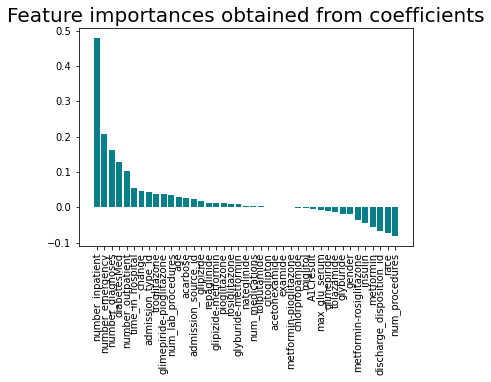

In [ ]:
plt.bar(x=importances['Attribute'], height=importances['Importance'], color='#087E8B')
plt.title('Feature importances obtained from coefficients', size=20)
plt.xticks(rotation='vertical')
plt.show()

In [ ]:
## Multi-class imbalanced Classification
# Balanced the three different readmission statuses instead of grouping them into 2 classes

In [ ]:
# check version number
import imblearn
print(imblearn.__version__)

0.8.1


Class=0, n=54861 (53.911%)
Class=2, n=35545 (34.929%)
Class=1, n=11357 (11.160%)


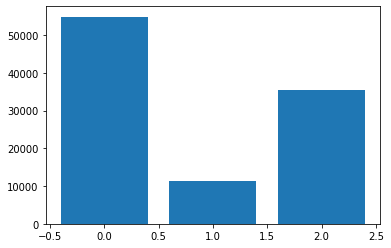

In [ ]:
# load and summarize the dataset
from pandas import read_csv
from collections import Counter
from matplotlib import pyplot
from sklearn.preprocessing import LabelEncoder

dataf = data.values
# split into input and output elements
X, y = dataf[:, :-1], dataf[:, -1]
# label encode the target variable
y = LabelEncoder().fit_transform(y)
# summarize distribution
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
pyplot.bar(counter.keys(), counter.values())
pyplot.show()

In [ ]:
data['race'].replace({"Caucasian":0, "AfricanAmerican":1, "Hispanic":2, "Asian":3, "Other":4, "Unknown":5}, inplace=True)

Class=0, n=54861 (33.333%)
Class=2, n=54861 (33.333%)
Class=1, n=54861 (33.333%)


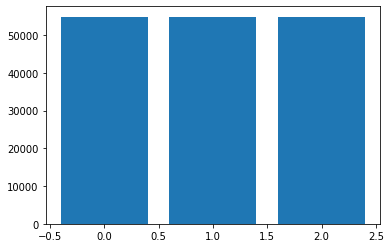

In [ ]:
# example of oversampling a multi-class classification dataset
from pandas import read_csv
from imblearn.over_sampling import SMOTE
from collections import Counter
from matplotlib import pyplot
from sklearn.preprocessing import LabelEncoder

datab = data.values
# split into input and output elements
X, y = datab[:, :-1], datab[:, -1]
# label encode the target variable
y = LabelEncoder().fit_transform(y)
# transform the dataset
oversample = SMOTE()
X, y = oversample.fit_resample(X, y)
# summarize distribution
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
pyplot.bar(counter.keys(), counter.values())
pyplot.show()